<a href="https://colab.research.google.com/github/Kur1sutaru/ruichenlabcodes/blob/main/Copy_of_Vizgen_Showcase_Mouse_Liver_0_2_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Vizgen Showcase Mouse Liver

The [Vizgen MERFISH Mouse Liver Map](https://info.vizgen.com/mouse-liver-access) dataset contains a MERFISH measurement of a 347 gene panel. The dataset includes detected transcripts, gene counts per cell, cell spatial metadata, cell boundaries, and DAPI images. This notebook performs

* single-cell analysis to identify clusters of cells
* assess tentative cell type using marker genes
* identify blood vessels in the mouse liver
* identify genes/cell-clusters that form gradients with respect to blood vessels
* identify clusters of overlapping cell-clusters using alpha-shape neighborhoods

### Notebook Overview Video

* YouTube Tutorial

# Required Initialization
#### Google Authentication

In [ ]:
# Authenticate
from google.colab import auth
auth.authenticate_user()

#### Pip installs

In [ ]:
%%capture
!pip install -q fsspec==2022.1.0
!pip install -q gcsfs==2022.1.0
!pip install -q scanpy==1.8.2
!pip install -q leidenalg==0.8.8
!pip install -q observable-jupyter==0.1.12
!pip install -q clustergrammer2==0.18.0
!pip install -q loompy==3.0.6
!pip install -q pygeos==0.12.0
!pip install -q geopandas==0.10.2

#### Imports

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
import scanpy as sc
import pygeos
import scanpy as sc
from matplotlib import pyplot as plt
from observable_jupyter import embed
from clustergrammer2 import net, Network, CGM2
from scipy.stats.stats import pearsonr
from copy import deepcopy
from scipy import sparse
from matplotlib.pyplot import *
from shapely.geometry import MultiPolygon, Polygon, Point
from shapely import affinity
from scipy.spatial import Delaunay
import plotly.express as px

# Avoids scroll-in-the-scroll in the entire Notebook
from IPython.display import Javascript
def resize_colab_cell():
  display(Javascript('google.colab.output.setIframeHeight(0, true, {maxHeight: 5000})'))
get_ipython().events.register('pre_run_cell', resize_colab_cell)

from itertools import compress
from scipy import stats

# code for compressing data for visuals
import zlib, json, base64
def json_zip(j):
    zip_json_string = base64.b64encode(
        zlib.compress(
            json.dumps(j).encode('utf-8')
        )
    ).decode('ascii')
    return zip_json_string

/usr/local/lib/python3.7/dist-packages/geopandas/_compat.py:115: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


>> clustergrammer2 backend version 0.18.0


/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# Load Datasets
### Load Vizgen Mouse Dataset

In [ ]:
base_path = 'gs://vz-liver-showcase/'
dataset_name = 'Liver1Slice1/'

cell_by_gene = pd.read_csv(base_path + dataset_name + 'cell_by_gene.csv', index_col=0)
meta_cell = pd.read_csv(base_path + dataset_name + 'cell_metadata.csv', index_col=0)
meta_cell['barcodeCount'] = cell_by_gene.sum(axis=1)

# initialize meta_gene
meta_gene = pd.DataFrame(index=cell_by_gene.columns.tolist())

# drop blanks for single cell analysis
keep_genes = [x for x in cell_by_gene.columns.tolist() if 'Blank' not in x]

cell_by_gene = cell_by_gene[keep_genes]
meta_gene = meta_gene.loc[keep_genes]

meta_gene['expression'] = cell_by_gene.sum(axis=0)

vizgen_genes = meta_gene.index.tolist()

<IPython.core.display.Javascript object>

## Load Reference Dataset:

Here we load gene-level metadata from the publication [Spatial transcriptome profiling by MERFISH reveals fetal liver hematopoietic stem cell niche architecture](https://www.nature.com/articles/s41421-021-00266-1) in order to identify cell type marker genes. These marker genes will be used to tentatively assess cell-cluster composition. See MERFISH gene panel metadata: https://www.nature.com/articles/s41421-021-00266-1.

In [ ]:
gene_panel = 'https://static-content.springer.com/esm/art%3A10.1038%2Fs41421-021-00266-1/MediaObjects/41421_2021_266_MOESM1_ESM.xlsx'
df_ref_panel_ini = pd.read_excel(gene_panel, index_col=0)
df_ref_panel = df_ref_panel_ini.iloc[1:,:1]
df_ref_panel.index.name = None
df_ref_panel.columns = ['Function']

marker_genes = df_ref_panel[df_ref_panel['Function'].str.contains('marker')].index.tolist()
common_marker_genes = list(set(meta_gene.index.tolist()).intersection(marker_genes))
meta_gene.loc[common_marker_genes, 'Markers'] = df_ref_panel.loc[common_marker_genes, 'Function']
meta_gene['Markers'] = meta_gene['Markers'].apply(lambda x: 'N.A.' if 'marker' not in str(x) else x)
meta_gene['Markers'].value_counts()

<IPython.core.display.Javascript object>

N.A.                            285
HSC marker                        8
Hepatocyte marker                 5
Erythroid progenitor marker       5
Macrophage marker                 5
SEC marker                        5
Neutrophil marker                 5
MK marker                         5
Potential HSC marker              5
Pre-B cell marker                 5
Erythroid cell marker             4
EC marker                         4
AEC marker                        2
Myeloid marker                    2
Macrophage/Hepatocyte marker      1
Basophil marker                   1
Name: Markers, dtype: int64

# Cluster Gene Expression Data
Here we load the Vizgen single-cell gene expression data into Scanpy to perform preprcessing (normalization and log transformation), dimensionality reduction (PCA, neighborhood calculation, UMAP), and clustering (Leiden clustering).

Filter out low expressing cells

<IPython.core.display.Javascript object>

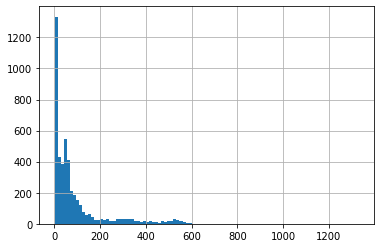

In [ ]:
meta_cell['barcodeCount'].value_counts().hist(bins=100)

In [ ]:
min_count = 50
keep_cells = meta_cell[meta_cell['barcodeCount'] >= min_count].index.tolist()
meta_cell = meta_cell.loc[keep_cells]
cell_by_gene = cell_by_gene.loc[keep_cells]

# reset index of cell_by_gene and meta_cell
new_index = range(len(meta_cell.index.tolist()))
meta_cell.index = new_index
cell_by_gene.index = new_index
cell_by_gene.shape

<IPython.core.display.Javascript object>

(367335, 347)

In [ ]:
%%capture

ad_viz = sc.AnnData(X=cell_by_gene.values, obs=meta_cell, var=meta_gene)
ad_viz

resolution = 1.5

# Leiden Clustering
######################

# dividing by volume instead
sc.pp.normalize_total(ad_viz)
sc.pp.log1p(ad_viz)
sc.pp.scale(ad_viz, max_value=10)
sc.tl.pca(ad_viz, svd_solver='arpack')
sc.pp.neighbors(ad_viz, n_neighbors=10, n_pcs=20)
sc.tl.umap(ad_viz)
sc.tl.leiden(ad_viz, resolution=resolution)

# Calculate Leiden Signatures
#########################################
ser_counts = ad_viz.obs['leiden'].value_counts()
ser_counts.name = 'cell counts'
meta_leiden = pd.DataFrame(ser_counts)

cat_name = 'leiden'
sig_leiden = pd.DataFrame(columns=ad_viz.var_names, index=ad_viz.obs[cat_name].cat.categories)
for clust in ad_viz.obs[cat_name].cat.categories:
    sig_leiden.loc[clust] = ad_viz[ad_viz.obs[cat_name].isin([clust]),:].X.mean(0)
sig_leiden = sig_leiden.transpose()
leiden_clusters = ['Leiden-' + str(x) for x in sig_leiden.columns.tolist()]
sig_leiden.columns = leiden_clusters
meta_leiden.index = sig_leiden.columns.tolist()
meta_leiden['leiden'] = pd.Series(meta_leiden.index.tolist(), index=meta_leiden.index.tolist())

# generate colors for categories by plotting
sc.pl.umap(ad_viz, color="leiden", legend_loc='on data')
cats = ad_viz.obs['leiden'].cat.categories.tolist()
colors = list(ad_viz.uns['leiden_colors'])
cat_colors = dict(zip(cats, colors))

# colors for clustergrammer2
ser_color = pd.Series(cat_colors)
ser_color.name = 'color'
df_colors = pd.DataFrame(ser_color)
df_colors.index = ['Leiden-' + str(x) for x in df_colors.index.tolist()]

meta_gene['info'] = pd.Series('', index=meta_gene.index.tolist())
df_colors.loc[''] = 'white'

<IPython.core.display.Javascript object>

... storing 'Markers' as categorical


## Hierarchically Cluster Leiden Gene Expressin Data

In [ ]:
# Clip Z-score values for visual purposes
sig_leiden_clip = deepcopy(sig_leiden)
sig_leiden_clip[sig_leiden_clip < -5] = -5
sig_leiden_clip[sig_leiden_clip >= 5] = 5

# alphabetize genes
sig_leiden_clip = sig_leiden_clip.loc[sorted(sig_leiden_clip.index.tolist())]
sig_leiden_clip.head()

meta_gene = pd.DataFrame(index=sig_leiden.index.tolist())
meta_gene['Markers'] = pd.Series('N.A.', index=sig_leiden.index.tolist())
meta_gene.loc[common_marker_genes, 'Markers'] = df_ref_panel.loc[common_marker_genes, 'Function']

df_colors.loc['N.A.', 'color'] = 'white'

<IPython.core.display.Javascript object>

## Predict Cell Type Based on Top Expressed Marker Genes
Here we tentatively assign cell cluster cell type composition using marker gene expression. We assign a cell cluster to a cell type by calculating the distribution of cell type marker genes in the top 30 most up-regulated genes in each Leiden cluster. If there is a tie in the most abundant marker genes we assing the cluster to more than one tentative cell type.

In [ ]:
meta_leiden['Cell_Type'] = pd.Series('N.A.', index=meta_leiden.index.tolist())
num_top_genes = 30
for inst_cluster in sig_leiden.columns.tolist():
  top_genes = sig_leiden[inst_cluster].sort_values(ascending=False).index.tolist()[:num_top_genes]

  inst_ser = meta_gene.loc[top_genes, 'Markers']
  inst_ser = inst_ser[inst_ser != 'N.A.']
  ser_counts = inst_ser.value_counts()

  max_count = ser_counts.max()

  max_cat = '_'.join(sorted(ser_counts[ser_counts == max_count].index.tolist()))
  max_cat = max_cat.replace(' marker', '').replace(' ', '-')

  print(inst_cluster, max_cat)
  meta_leiden.loc[inst_cluster, 'Cell_Type'] = max_cat

<IPython.core.display.Javascript object>

Leiden-0 Hepatocyte
Leiden-1 SEC
Leiden-2 Hepatocyte
Leiden-3 SEC
Leiden-4 Hepatocyte
Leiden-5 Hepatocyte_SEC
Leiden-6 Hepatocyte
Leiden-7 Hepatocyte
Leiden-8 Macrophage
Leiden-9 Hepatocyte
Leiden-10 Hepatocyte
Leiden-11 Hepatocyte
Leiden-12 AEC
Leiden-13 AEC_Potential-HSC
Leiden-14 Macrophage
Leiden-15 HSC
Leiden-16 MK
Leiden-17 Neutrophil
Leiden-18 HSC_Pre-B-cell
Leiden-19 Neutrophil
Leiden-20 MK_Pre-B-cell_SEC
Leiden-21 HSC_Myeloid
Leiden-22 MK_Pre-B-cell_SEC
Leiden-23 MK
Leiden-24 Macrophage
Leiden-25 SEC
Leiden-26 Erythroid-cell_MK
Leiden-27 SEC
Leiden-28 Pre-B-cell
Leiden-29 AEC


### Rename Clusters

In [ ]:
meta_leiden.head()

<IPython.core.display.Javascript object>

,cell counts,leiden,Cell_Type
Leiden-0,40544,Leiden-0,Hepatocyte
Leiden-1,33756,Leiden-1,SEC
Leiden-2,30638,Leiden-2,Hepatocyte
Leiden-3,30574,Leiden-3,SEC
Leiden-4,27207,Leiden-4,Hepatocyte


In [ ]:
meta_leiden['name'] = meta_leiden.apply(lambda x: x['Cell_Type'] + '_' + x['leiden'] , axis=1)
leiden_names = meta_leiden['name'].values.tolist()
meta_leiden.index = leiden_names
sig_leiden_clip.columns = leiden_names

<IPython.core.display.Javascript object>

In [ ]:
meta_leiden.head()

<IPython.core.display.Javascript object>

,cell counts,leiden,Cell_Type,name
Hepatocyte_Leiden-0,40544,Leiden-0,Hepatocyte,Hepatocyte_Leiden-0
SEC_Leiden-1,33756,Leiden-1,SEC,SEC_Leiden-1
Hepatocyte_Leiden-2,30638,Leiden-2,Hepatocyte,Hepatocyte_Leiden-2
SEC_Leiden-3,30574,Leiden-3,SEC,SEC_Leiden-3
Hepatocyte_Leiden-4,27207,Leiden-4,Hepatocyte,Hepatocyte_Leiden-4


### Vizualization code

In [ ]:
%%capture

# hierarchically cluster leiden signatures
net = Network(CGM2)
net.load_df(sig_leiden_clip, meta_col=meta_leiden, col_cats=['leiden', 'Cell_Type', 'cell counts'],
            meta_row=meta_gene, row_cats=['Markers'])
net.filter_threshold(0.01, axis='row')
net.set_global_cat_colors(df_colors)
net.cluster()

# Collect data for interactive visualization
################################################
cell_by_gene.index = range(len(cell_by_gene.index.tolist()))
gex_int = cell_by_gene.astype(np.int)

# new gex_dict
###################
gex_dict = {}
min_exp = 5
max_exp = 255
max_pos_cells = 40000
for inst_gene in gex_int.columns.tolist():
    if 'Blank' not in inst_gene:
        ser_gene = gex_int[inst_gene]
        ser_gene[ser_gene > max_exp] = max_exp
        ser_gene = ser_gene[ser_gene > min_exp]
        ser_gene = ser_gene.astype(np.uint8)

        if ser_gene.shape[0] > max_pos_cells:
          # print(inst_gene, ser_gene.shape)
          keep_cells = ser_gene.sort_values(ascending=False).index.tolist()[:max_pos_cells]
          ser_gene = ser_gene[keep_cells]

        # dictonary
        gex_dict[inst_gene] = ser_gene.to_dict()

zip_gex_dict = json_zip(gex_dict)


df_pos = ad_viz.obs[['center_x', 'center_y', 'leiden']]
df_pos[['center_x', 'center_y']] = df_pos[['center_x', 'center_y']].round(2)
df_pos.columns = ['x', 'y', 'leiden']
df_pos['y'] = -df_pos['y']
df_umap = ad_viz.obsm.to_df()[['X_umap1', 'X_umap2']].round(2)
df_umap.columns = ['umap-x', 'umap-y']

df_name = pd.DataFrame(df_pos.index.tolist(), index=df_pos.index.tolist(), columns=['name'])

df_obs = pd.concat([df_name, df_pos, df_umap], axis=1)
data = df_obs.to_dict('records')

obs_data = {
    # 'gex_dict': gex_dict,
    # 'gex_dict': {},
    'data': data,
    'cat_colors': cat_colors,
    'network': net.viz
}

zip_obs_data = json_zip(obs_data)


inputs = {
    'zoom': -3.75,
    'ini_cat': 'leiden',
    'ini_map_type': 'Spatial',
    'ini_min_radius': 1.0,
    'zip_obs_data': zip_obs_data,
    'zip_gex_dict': zip_gex_dict,
    'gex_opacity_contrast_scale': 0.85,
    'center_x': 5000,
    'center_y': 5000
}

# initialize df_points DataFrame for neighborhood calculations
df_points = pd.concat([df_name, df_pos], axis=1)

<IPython.core.display.Javascript object>

## UMAP-Spatial-Heatmap Single-Cell View
Here we visualize Vizgen single-cell gene expression data using an interacive scatterplot and heatmap. On the left, cells can be arranged based on their spatial location in the tissue or based on their dimensionality reduced UMAP embedding. Cells can be colored using their Leiden cluster or the expression of any gene - note for the purpose of embedding this interactive visualization we have set the mimimum number of transcripts per cell to 5 and a maximum number of positive cells for any gene to 40,000. Genes can be selected from the dropdown above the scatterplot or by clicking a gene row in the interactive heatmap built using [clustergrammer2](https://github.com/ismms-himc/clustergrammer2) and will color cells based on the expression of this gene. The heatmap can also be used to identify genes that are correlated across leiden clusters, as well as the hierarchy of cell-cluster gene expression. This visual enabels users to interactively explore Vizgen's high-dimensional gene expression data and simultaneously observe the spatial locations/morphologies of single-cells in the tissue. See below for more in-depth discussion of selected cell-clusters.



In [ ]:
embed('@vizgen/umap-spatial-heatmap-single-cell-0-3-1', cells=['viewof cgm', 'dashboard'], inputs=inputs, display_logo=False)

<IPython.core.display.Javascript object>

### Hepatocytes
Eight Leiden clusters are identified as hepatocyte cells. Using the expression of Axin2 as a marker for peri-central hepatocytes ([see Sun et. al.](https://pubmed.ncbi.nlm.nih.gov/31866224/)) we are able to identify peri-central and peri-portal clusters of hepatocytes, which display intricate spatial localization throughout the tissue.

#### Peri-Portal Meta-Cluster

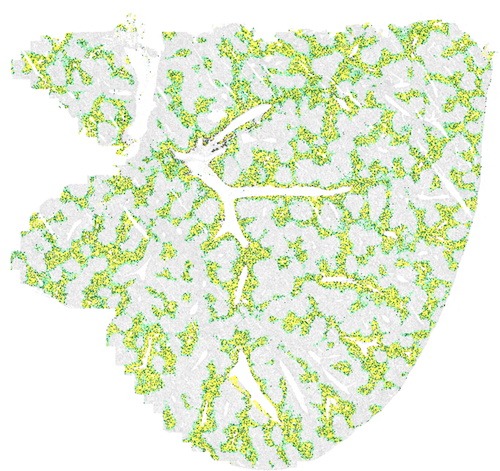

#### Peri-Central Meta-Cluster

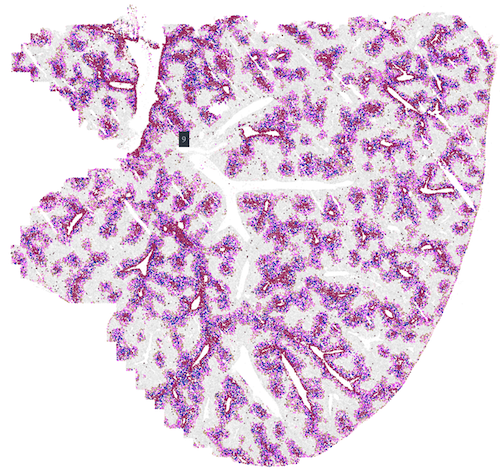

### Blood Vessel Adjacent
Using the expression of Vwf as a marker for endothelial or endothelial adjacent cells we can identify clusters (e.g. Leiden-16) that are specifically located at blood vessels (see ([Nightingale et. al.](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4255685/)).

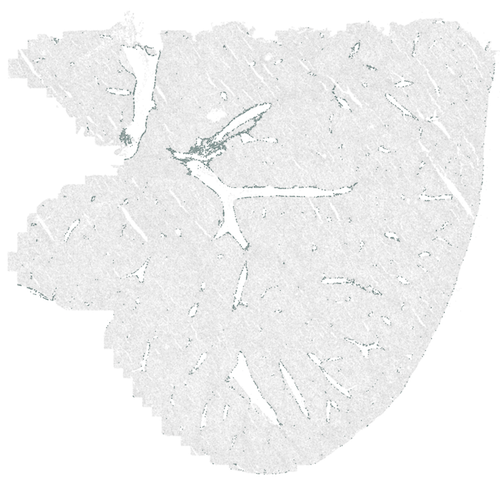

# Identify Blood Vessels and Spatially Correlated Genes/Clusters

Vizgen's spatial transcriptomics data enables users to identify tissue ultra-structure and perform spatial analysis with respect to these structures. Here we demonstrate how we can use an alpha-shape approach to identify holes in the mouse liver, use local gene expression to classify the liver tissue holes (e.g. portal vein, central vein, or artifact), and finally identify genes and cell-clusters that show correlated expression with respect to distance to blood vessels.

### Alpha Shape Functions

In [ ]:
def calc_alpha_shape(points, alpha, only_outer=True):
    """
    Compute the alpha shape (concave hull) of a set of points.
    :param points: np.array of shape (n,2) points.
    :param alpha: dalpha value.
    :param only_outer: boolean value to specify if we keep only the outer border
    or also inner edges.
    :return: set of (i,j) pairs representing edges of the alpha-shape. (i,j) are
    the indices in the points array. and array of triangle indices

    # from https://stackoverflow.com/a/50159452/3957721
    # also see https://stackoverflow.com/a/50714300/3957721
    """
    assert points.shape[0] > 3, "Need at least four points"

    def add_edge(edges, i, j):
        """
        Add a line between the i-th and j-th points,
        if not in the list already
        """
        if (i, j) in edges or (j, i) in edges:
            # already added
            assert (j, i) in edges, "Can't go twice over same directed edge right?"
            if only_outer:
                # if both neighboring triangles are in shape, it is not a boundary edge
                edges.remove((j, i))
            return
        edges.add((i, j))

    tri = Delaunay(points)
    edges = set()

    # Loop over triangles:
    # ia, ib, ic = indices of corner points of the triangle
    keep_triangles = []
    for ia, ib, ic in tri.simplices:
        pa = points[ia]
        pb = points[ib]
        pc = points[ic]
        # Computing radius of triangle circumcircle
        # www.mathalino.com/reviewer/derivation-of-formulas/derivation-of-formula-for-radius-of-circumcircle
        a = np.sqrt((pa[0] - pb[0]) ** 2 + (pa[1] - pb[1]) ** 2)
        b = np.sqrt((pb[0] - pc[0]) ** 2 + (pb[1] - pc[1]) ** 2)
        c = np.sqrt((pc[0] - pa[0]) ** 2 + (pc[1] - pa[1]) ** 2)

        # # original filtering
        # s = (a + b + c) / 2.0
        # area = np.sqrt(s * (s - a) * (s - b) * (s - c))
        # circum_r = a * b * c / (4.0 * area)
        # if circum_r < alpha:
        #     add_edge(edges, ia, ib)
        #     add_edge(edges, ib, ic)
        #     add_edge(edges, ic, ia)
        #     keep_triangles.append([ia, ib, ic])

        # new filtering based on triangle length
        # we probably want to add an index to the triangles that we can
        # use to associate with specific sub-regions
        if a < alpha and b < alpha and c < alpha:
            add_edge(edges, ia, ib)
            add_edge(edges, ib, ic)
            add_edge(edges, ic, ia)
            keep_triangles.append([ia, ib, ic])

    return edges, tri, keep_triangles

def find_edges_with(i, edge_set):
    i_first = [j for (x,j) in edge_set if x==i]
    i_second = [j for (j,x) in edge_set if x==i]
    return i_first,i_second

def stitch_boundaries(edges):
    edge_set = edges.copy()
    boundary_lst = []
    while len(edge_set) > 0:
        boundary = []
        edge0 = edge_set.pop()
        boundary.append(edge0)
        last_edge = edge0
        while len(edge_set) > 0:
            i,j = last_edge
            j_first, j_second = find_edges_with(j, edge_set)
            if j_first:
                edge_set.remove((j, j_first[0]))
                edge_with_j = (j, j_first[0])
                boundary.append(edge_with_j)
                last_edge = edge_with_j
            elif j_second:
                edge_set.remove((j_second[0], j))
                edge_with_j = (j, j_second[0])  # flip edge rep
                boundary.append(edge_with_j)
                last_edge = edge_with_j

            if edge0[0] == last_edge[1]:
                break

        boundary_lst.append(boundary)
    return boundary_lst

<IPython.core.display.Javascript object>

In [ ]:
def calc_deckgl_triangles(keep_triangles):
  deckgl_triangles = []
  for triangle_id, inst_triangle in enumerate(keep_triangles):

    point_a = points[inst_triangle[0]]
    point_b = points[inst_triangle[1]]
    point_c = points[inst_triangle[2]]

    # collect the coordinates and invert the y coordinate
    # deckgl plots inverted
    coordinates = [
            [point_a[0], -point_a[1]],
            [point_b[0], -point_b[1]],
            [point_c[0], -point_c[1]],
            ]


    deckgl_triangles.append(
        {
          'name': '0',
          'coordinates': coordinates,
          'color': [0, 255, 0],
          'id': triangle_id
        }
    )
  return deckgl_triangles

<IPython.core.display.Javascript object>

In [ ]:
def calc_deckgl_polygons(points, boundary_list, invert_y_for_deck=True):
  deckgl_polygons = []
  for boundary in boundary_list:

    num_edges = len(boundary)
    coordinates = []
    for edge_index, edge in enumerate(boundary):

      inst_point = edge[0]

      if invert_y_for_deck:
        # collect the coordinates and invert the y coordinate
        # deckgl plots inverted
        coord = [points[inst_point][0], -points[inst_point][1]]
      else:
        # do not invert the coordinates because we are going to
        # use this for shapely
        coord = [points[inst_point][0], points[inst_point][1]]

      coordinates.append(coord)

    deckgl_polygons.append(
        {
          'name': '0',
          'coordinates': coordinates,
          'color': [0, 0, 255]
        }
    )
  return deckgl_polygons

<IPython.core.display.Javascript object>

In [ ]:
def calc_deckgl_points(df_points):

  df_deckgl = deepcopy(df_points)

  # collect the coordinates and invert the y coordinate
  # deckgl plots inverted
  df_deckgl['y'] = - df_deckgl['y']

  deckgl_points = df_deckgl.to_dict('records')

  return deckgl_points

<IPython.core.display.Javascript object>

In [ ]:
def curate_alpha_shape_polygons(df_shape, cluster_name):

  # See above aproach to transfer coordinates into Shapely shape with holes
  # https://stackoverflow.com/a/48771070/3957721

  # print('curate_alpha_shape_polygons')
  # print('calculate sparse partition matrix')

  ser_shapes = gpd.GeoSeries(df_shape['shape'].values).buffer(0)
  inside, outside = ser_shapes.sindex.query_bulk(ser_shapes, predicate='contains')
  # sparse_partition = sparse.csc_matrix((np.ones_like(inside), (inside, outside)))
  sparse_partition = sparse.csr_matrix((np.ones_like(inside), (inside, outside)))

  # get the names of the real holes (not a hole of a hole)
  is_hole = (sparse_partition.sum(axis=0) % 2 - 1).astype(bool)
  is_hole = list(np.array(is_hole)[0])
  available_hole_names = df_shape[is_hole].index.tolist()

  # print('available_hole_names', available_hole_names)

  curated_polygons = []
  all_shapes = df_shape.index.tolist()
  region_id = 0

  shape_names = df_shape.index.tolist()

  for shape_name in all_shapes:

    if shape_name not in available_hole_names:

      # simplified hole curation
      ################################
      ################################
      # print('\n')
      # print('shape_name')
      # print('---------------')

      inst_deckgl_coords = df_shape.loc[shape_name, 'deckgl_polygon']['coordinates']
      hole_list = []
      has_holes = False

      # find the potential holes for a shape
      ini_hole_masks = list(sparse_partition[shape_name,:].toarray()[0].astype(bool))
      ini_hole_names = list(compress(shape_names, ini_hole_masks))

      # print('ini_hole_names', ini_hole_names)

      potential_holes = sorted(list(set(ini_hole_names).intersection(available_hole_names)))

      # drop holes that are holes of another hole
      ser_sum = pd.DataFrame(sparse_partition.toarray()).loc[potential_holes, potential_holes].sum()
      hole_list = ser_sum[ser_sum == 1].index.tolist()

      # print('shape_name', shape_name)
      # print('hole_list')
      # print(hole_list)

      if len(hole_list) == 0:
        curated_polygon = inst_deckgl_coords
      else:
        has_holes = True
        curated_polygon = [inst_deckgl_coords]
        for inst_hole in hole_list:
          hole_deckgl_coords = df_shape.loc[inst_hole, 'deckgl_polygon']['coordinates']
          curated_polygon.append(hole_deckgl_coords)

      curated_polygons.append({
          'neighborhood': cluster_name,
          'region_id': shape_name,
          'name': 'cluster-' + str(cluster_name) + '_region-' + str(region_id),
          'coordinates': curated_polygon,
          'has_holes': has_holes
      })

      region_id = region_id +1

  return curated_polygons

<IPython.core.display.Javascript object>

In [ ]:
def calc_alpha_shapes_for_deckgl(df_points, alpha, cluster_name='leiden'):
  print('calc_alpha_shapes_for_deckgl')

  # returns deckgl_polygons stored as a python object
  deckgl_points = calc_deckgl_points(df_points)
  deckgl_polygons = []
  contained_points = {}

  cluster_numbers = [np.int(x) for x in df_points['leiden'].unique().tolist()]
  ordered_cluster_names = [str(y) for y in sorted(cluster_numbers)]
  for inst_leiden in ordered_cluster_names:

    # points = df_points[df_points['leiden'] == inst_leiden][['x','y']].values

    df_points_leiden = df_points[df_points['leiden'] == inst_leiden]

    # make a series of point names for slicing later
    ser_point_names = pd.Series(df_points_leiden.index.tolist())
    points = df_points_leiden[['x','y']].values

    # Computing the alpha shape
    edges, tri, keep_triangles = calc_alpha_shape(points, alpha=alpha, only_outer=True)

    # extract contained points from the lists of triangles
    ini_found_index_list = [item for sublist in keep_triangles for item in sublist]
    found_index_list = sorted(list(set(ini_found_index_list)))
    found_points_list = ser_point_names.loc[found_index_list].values.tolist()
    contained_points[inst_leiden] = found_points_list

    # print(len(found_point_list), found_point_list[:3])

    boundary_list = stitch_boundaries(edges)

    # convert boundary lists into an initial set of polygons compatible with deck.gl
    ini_deckgl_polygons = calc_deckgl_polygons(points, boundary_list)

    # save the polygons into a DataFrame for ease of use
    ser_deckgl = pd.Series(ini_deckgl_polygons)
    df_shape = pd.DataFrame()
    # save series of deckgl polygons as column in the DataFrame
    df_shape['deckgl_polygon'] = ser_deckgl

    # make shapely polygon and calculate area
    for inst_index, deckgl_polygon in enumerate(ini_deckgl_polygons):
      inst_shape = Polygon(deckgl_polygon['coordinates'])
      df_shape.loc[inst_index, 'shape'] = inst_shape
      df_shape.loc[inst_index, 'area'] = inst_shape.area

    # curate polygons:
    if df_shape.shape[0] > 0:
      # sort based on polygon area
      df_shape.sort_values('area', ascending=False, inplace=True)

      # reindex shapes
      #####################
      df_shape.index = list(range(df_shape.shape[0]))

      # organize polygons to correctly assign holes to polygons
      curated_polygons = curate_alpha_shape_polygons(df_shape, inst_leiden)
      # collect to list of deckgl_polygons
      deckgl_polygons.extend(curated_polygons)

  return deckgl_polygons, deckgl_points, contained_points

<IPython.core.display.Javascript object>

In [ ]:
def calc_neighborhood_multipolygons(deckgl_polygons):
  '''returns a dictionary of neighborhoods stored as shapely multipolygons'''
  meta_nbhds = pd.DataFrame()
  meta_regions = pd.DataFrame()
  shapely_polygons = {}
  for inst_polygon in deckgl_polygons:

    # collect outer coordinates
    has_holes = inst_polygon['has_holes']
    if has_holes == False:
      # outer_coords = [tuple(x) for x in inst_polygon['coordinates']]
      outer_coords = [tuple([x[0], -x[1]]) for x in inst_polygon['coordinates']]
    else:
      # outer_coords = [tuple(x) for x in inst_polygon['coordinates'][0]]
      outer_coords = [tuple([x[0], -x[1]]) for x in inst_polygon['coordinates'][0]]

    # collect hole coordinates
    hole_coords = []
    if has_holes:
      num_holes = len(inst_polygon['coordinates']) - 1
      for inst_hole in range(num_holes):
        hole_index = inst_hole + 1
        # hole_tuple = [tuple(x) for x in inst_polygon['coordinates'][hole_index]]
        hole_tuple = [tuple([x[0], -x[1]]) for x in inst_polygon['coordinates'][hole_index]]
        hole_coords.append(hole_tuple)

    # calculate area without holes
    area_no_holes = Polygon(outer_coords, []).area

    # make single shapely polygon (with holes)
    shapely_polygon = Polygon(outer_coords, hole_coords)

    # neighborhood name
    neighborhood = inst_polygon['neighborhood']

    if neighborhood not in shapely_polygons:
      shapely_polygons[neighborhood] = []

    shapely_polygons[neighborhood].append(shapely_polygon)

    region_name = inst_polygon['name']
    meta_regions.loc[region_name, 'neighborhood'] = neighborhood
    meta_regions.loc[region_name, 'area'] = shapely_polygon.area
    meta_regions.loc[region_name, 'area_no_holes'] = area_no_holes
    meta_regions.loc[region_name, 'perimeter'] = shapely_polygon.length
    meta_regions.loc[region_name, 'area_per_perimeter'] = shapely_polygon.area/shapely_polygon.length
    meta_regions.loc[region_name, 'num_holes'] = len(hole_coords)

  # assemble multipolygons
  cluster_numbers = [np.int(x) for x in df_points['leiden'].unique().tolist()]
  ordered_cluster_names = [str(y) for y in sorted(cluster_numbers)]
  nbhds = {}
  for nbhd in ordered_cluster_names:
    if nbhd in shapely_polygons:
      multi_polygon = MultiPolygon(shapely_polygons[nbhd])

      # multi_polygon = affinity.rotate(multi_polygon, 180, 'center')

      nbhds[nbhd] = multi_polygon
      num_regions = len(list(multi_polygon))
      nbhd_area = multi_polygon.area
      nbhd_perimeter = multi_polygon.length
      nbhd_area_per_perimeter = nbhd_area/nbhd_perimeter

    else:
      nbhds[nbhd] = MultiPolygon()
      num_regions = 0
      nbhd_area = 0
      nbhd_perimeter = 0
      nbhd_area_per_perimeter = np.nan

    meta_nbhds.loc[nbhd, 'num_regions'] = num_regions
    meta_nbhds.loc[nbhd, 'area'] = nbhd_area
    meta_nbhds.loc[nbhd, 'perimeter'] = nbhd_perimeter
    meta_nbhds.loc[nbhd, 'area_per_perimeter'] = nbhd_area_per_perimeter

  return nbhds, meta_nbhds, meta_regions

<IPython.core.display.Javascript object>

### Calculate Liver-Tissue Alpha Shape
Here we are using an alpha shape approach to calculate the polygon describing the mouse liver. Next we identify the holes in the polygon and begin the classification process using local gene expression.

In [ ]:
df_points_liver = deepcopy(df_points)
df_points_liver['leiden'] = pd.Series('0', index=df_points_liver.index.tolist())

# Calculate Alpha Shapes
#################################
alpha_liver = 50
deckgl_polygons_liver, deckgl_points_liver, contained_points_liver = calc_alpha_shapes_for_deckgl(df_points_liver, alpha=alpha_liver)

# Calculate Neighborhood Shapely Multipolygons
################################################
nbhds_liver, meta_nbhds_liver, meta_regions_liver = calc_neighborhood_multipolygons(deckgl_polygons_liver)

<IPython.core.display.Javascript object>

calc_alpha_shapes_for_deckgl


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for addi

<IPython.core.display.Javascript object>

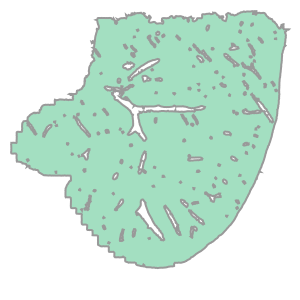

In [ ]:
liver_ini = nbhds_liver['0'].geoms[0]
liver_ini = liver_ini.buffer(0)
liver = liver_ini.geoms[1]
liver

In [ ]:
interiors = liver.interiors
df_holes = gpd.GeoDataFrame()

buffer_dist = 25
interior_buffer = -5
df_donuts = gpd.GeoDataFrame()

for index, interior in enumerate(interiors):

  inst_polygon = Polygon(interior)

  inst_donut = inst_polygon.buffer(buffer_dist).difference(inst_polygon.buffer(interior_buffer))

  df_holes.loc[index, 'geometry'] = inst_polygon

  df_donuts.loc[index, 'geometry'] = inst_donut

df_holes['area'] = df_holes['geometry'].area
df_donuts['area'] = df_donuts['geometry'].area

<IPython.core.display.Javascript object>

Here we identify which cells are close to each liver hole. We define a region surrounding each hole (which we are reffering to as a donut) and then identify which cells are contained within this region.

In [ ]:
geo_cells = gpd.points_from_xy(meta_cell.center_x, -meta_cell.center_y)

partition_mat = geo_cells.sindex.query_bulk(df_donuts['geometry'], predicate='contains')
ser_partition = pd.Series(partition_mat.T[:,0], index=partition_mat.T[:,1])

list_ser = []
all_donuts = sorted(list(ser_partition.unique()))

for inst_donut in all_donuts:
  ser_donut = ser_partition[ser_partition == inst_donut]

  inst_cells = [str(x) for x in ser_donut.index.tolist()]
  meta_donut_cells = ad_viz.obs.loc[inst_cells]

  inst_ser = meta_donut_cells['leiden'].value_counts()
  inst_ser.name = inst_donut

  list_ser.append(inst_ser)

df_donuts_leiden = pd.concat(list_ser, axis=1)
df_donuts_leiden.columns = ['H-' + str(x) for x in df_donuts_leiden.columns]
df_donuts_leiden.index = ['Leiden-' + str(x) for x in df_donuts_leiden.index]

meta_holes = df_holes[['area']]
meta_holes.index = ['H-' + str(x) for x in meta_holes.index.tolist()]

<IPython.core.display.Javascript object>

#### All Mouse Liver Holes
Here we display all mouse liver holes (identified in the largest section of the liver) in black. Next, we will classify as blood vessel or artifact.

<IPython.core.display.Javascript object>

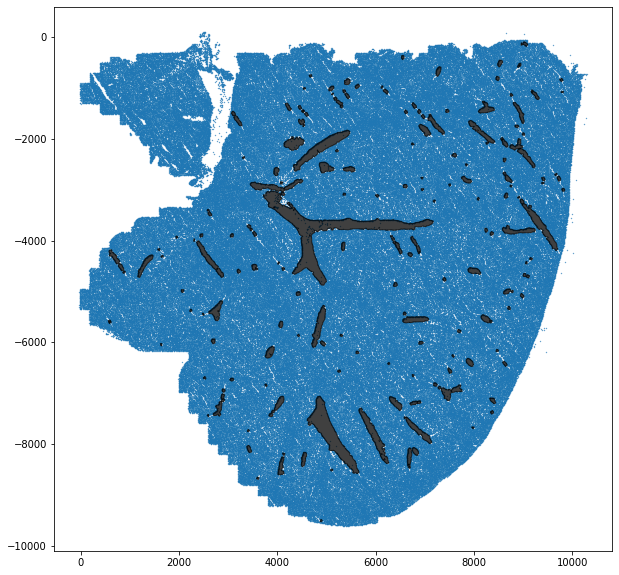

In [ ]:
figsize=10
plt.figure(figsize=(figsize, figsize))
plt.scatter(meta_cell.center_x, -meta_cell.center_y, s=0.1)
for inst_hole in df_holes.index.tolist():
  inst_geo = df_holes.loc[inst_hole, 'geometry']
  boundary = inst_geo.boundary.xy
  plt.fill(*boundary, alpha=0.75, color='black')

### Calculate the gene expression signatures of the surrounding areas of the holes
Here we calculate the gene expression signatures of the region surrounding the holes in order to classify.

In [ ]:
list_ser = []
all_donuts = sorted(list(ser_partition.unique()))
for inst_donut in all_donuts:
  ser_donut = ser_partition[ser_partition == inst_donut]
  inst_cells = ser_donut.index.tolist()

  inst_ser = cell_by_gene.loc[inst_cells].mean(axis=0)
  inst_ser.name = inst_donut
  list_ser.append(inst_ser)

df_donuts_gex = pd.concat(list_ser, axis=1)
df_donuts_gex.columns = ['H-' + str(x) for x in df_donuts_gex.columns]
df_donuts_gex.index = [str(x) for x in df_donuts_gex.index]

df_donuts_gex_norm = df_donuts_gex.divide(df_donuts_gex.sum(axis=0))
df_donuts_gex_norm.sum(axis=0)

<IPython.core.display.Javascript object>

H-0      1.0
H-1      1.0
H-2      1.0
H-3      1.0
H-4      1.0
        ... 
H-202    1.0
H-203    1.0
H-204    1.0
H-205    1.0
H-206    1.0
Length: 207, dtype: float64

#### Classify Blood Vessels
First, we classify as blood vessel or artifact based on local expression of the endothelial marker gene Vwf - holes with a high level of Vwf are assigned to blood vessels.

<IPython.core.display.Javascript object>

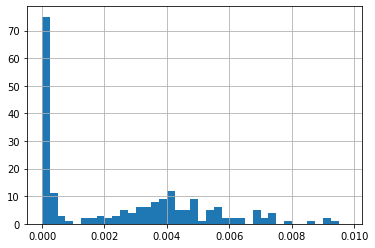

In [ ]:
ser_vwf = df_donuts_gex_norm.loc['Vwf']
ser_vwf.hist(bins=np.arange(0, 0.01, 0.00025))

In [ ]:
thresh_blood_vessel = 0.0004
blood_vessels = ser_vwf[ser_vwf > thresh_blood_vessel].index.tolist()
meta_holes['Type'] = pd.Series('Artifact', index=meta_holes.index.tolist())
meta_holes.loc[blood_vessels, 'Type'] = 'Blood Vessel'
meta_holes['Type'].value_counts()

<IPython.core.display.Javascript object>

Blood Vessel    126
Artifact         81
Name: Type, dtype: int64

#### Mouse Liver Blood Vessels
Here we display blood vessels in purple and artifacts in black. Note how artifacts (e.g. scrapes) are often in the same orientation.

<IPython.core.display.Javascript object>

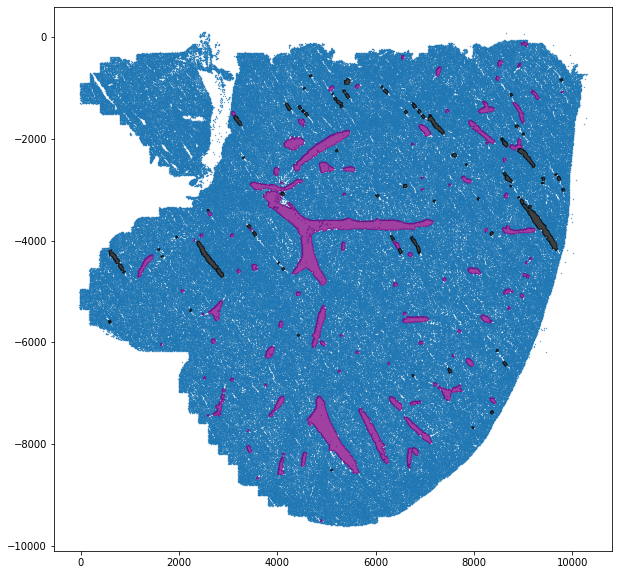

In [ ]:
figsize=10
plt.figure(figsize=(figsize, figsize))
plt.scatter(meta_cell.center_x, -meta_cell.center_y, s=0.1)
for inst_hole in df_holes.index.tolist():
  inst_geo = df_holes.loc[inst_hole, 'geometry']
  boundary = inst_geo.boundary.xy
  hole_cat = meta_holes.loc['H-' + str(inst_hole), 'Type']
  if hole_cat == 'Blood Vessel':
    plt.fill(*boundary, alpha=0.75, color='purple')
  else:
    plt.fill(*boundary, alpha=0.75, color='black')

#### Classify Portal vs Central Blood Vessels
Here we use the peri-central marker gene Axin2 to assign blood vessels to Portal or Central - high Axin2 is used to assign central vessels.

<IPython.core.display.Javascript object>

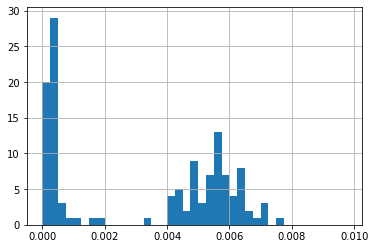

In [ ]:
ser_axin2 = df_donuts_gex_norm.loc['Axin2', blood_vessels]
ser_axin2.hist(bins=np.arange(0, 0.01, 0.00025))

In [ ]:
keep_central = ser_axin2[ser_axin2 > 0.002].index.tolist()
meta_holes.loc[blood_vessels, 'Type'] = 'Peri-Portal'
meta_holes.loc[keep_central, 'Type'] = 'Peri-Central'
meta_holes['Type'].value_counts()

<IPython.core.display.Javascript object>

Artifact        81
Peri-Central    70
Peri-Portal     56
Name: Type, dtype: int64

#### Mouse Liver Portal (red) and Central (blue) Blood Vessels
Here we display portal blood vessels in red (e.g. high oxygen) and central blood vessels in blue (e.g. low oxygen).

<IPython.core.display.Javascript object>

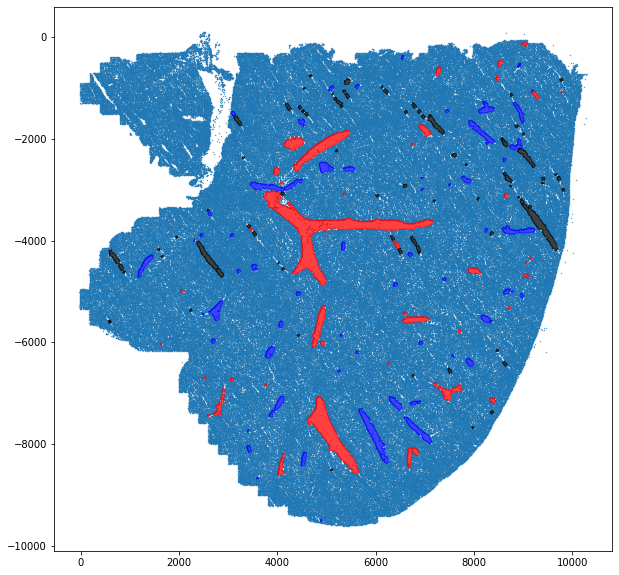

In [ ]:
figsize=10
plt.figure(figsize=(figsize, figsize))
plt.scatter(meta_cell.center_x, -meta_cell.center_y, s=0.1)
for inst_hole in df_holes.index.tolist():
  inst_geo = df_holes.loc[inst_hole, 'geometry']
  boundary = inst_geo.boundary.xy
  hole_cat = meta_holes.loc['H-' + str(inst_hole), 'Type']
  if hole_cat == 'Peri-Portal':
    plt.fill(*boundary, alpha=0.75, color='red')
  elif hole_cat == 'Peri-Central':
    plt.fill(*boundary, alpha=0.75, color='blue')
  else:
    plt.fill(*boundary, alpha=0.75, color='black')

### Calculate Genes and Cell-Clusters Blood Vessel Correlations
Here we calculate the surrounding areas around portal and central blood vessles in 20um increments in order to calculate which genes and cell-clusters show the most correlated expression with respect to their proximity to the blood vessels.

In [ ]:
vessels = {}
peri_portal_indexes = [int(x.split('-')[1]) for x in meta_holes[meta_holes['Type'] == 'Peri-Portal'].index.tolist()]
vessels['portal'] = MultiPolygon(df_holes.loc[peri_portal_indexes, 'geometry'].values)

peri_central_indexes = [int(x.split('-')[1]) for x in meta_holes[meta_holes['Type'] == 'Peri-Central'].index.tolist()]
vessels['central'] = MultiPolygon(df_holes.loc[peri_central_indexes, 'geometry'].values)

buffer_dist = 20
num_donuts = 10
portal_donuts = gpd.GeoDataFrame()
central_donuts = gpd.GeoDataFrame()

portal_exp = pd.DataFrame()
central_exp = pd.DataFrame()

portal_leiden = pd.DataFrame()
central_leiden = pd.DataFrame()

for donut_index in range(num_donuts):

  for inst_type in ['portal', 'central']:

    # portal donuts
    inst_inner = vessels[inst_type].buffer(donut_index * buffer_dist )
    inst_outer = vessels[inst_type].buffer((donut_index + 1) * buffer_dist)
    inst_donut = inst_outer.difference(inst_inner)

    partition_mat = geo_cells.sindex.query_bulk(inst_donut, predicate='contains')
    inst_cells = list(partition_mat[1,:])

    leiden_counts = ad_viz.obs.loc[[str(x) for x in inst_cells]]['leiden'].value_counts()
    leiden_counts = leiden_counts/leiden_counts.sum()

    ser_exp = cell_by_gene.loc[inst_cells].mean(axis=0)

    if inst_type == 'portal':
      portal_donuts.loc[donut_index, 'geometry'] = inst_donut
      portal_exp[donut_index] = ser_exp
      portal_leiden[donut_index] = leiden_counts
    else:
      central_donuts.loc[donut_index, 'geometry'] = inst_donut
      central_exp[donut_index] = ser_exp
      central_leiden[donut_index] = leiden_counts

portal_exp.columns = [str(x) for x in portal_exp.columns.tolist()]
central_exp.columns = [str(x) for x in central_exp.columns.tolist()]

portal_leiden.columns = [str(x) for x in portal_leiden.columns.tolist()]
central_leiden.columns = [str(x) for x in central_leiden.columns.tolist()]

distances = pd.Series([int(x) for x in portal_leiden.columns.tolist()]).sort_values(ascending=False).values.tolist()

<IPython.core.display.Javascript object>

/usr/local/lib/python3.7/dist-packages/pandas/core/dtypes/missing.py:531: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  val = np.array(val, copy=False)
/usr/local/lib/python3.7/dist-packages/pandas/core/dtypes/missing.py:531: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  val = np.array(val, copy=False)
/usr/local/lib/python3.7/dist-packages/pandas/core/dtypes/missing.py:531: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  val = np.array(val, copy=False)
/usr/local/lib/python3.7/dist-packages/pandas/core/

### Regions Surrounding Portal and Central Veins
Here we visualize the regions that we will use to calculate gene and cell-cluster gradients. Portal and central blood vessels are surrounded by areas of increasing distance (20um increments).

<IPython.core.display.Javascript object>

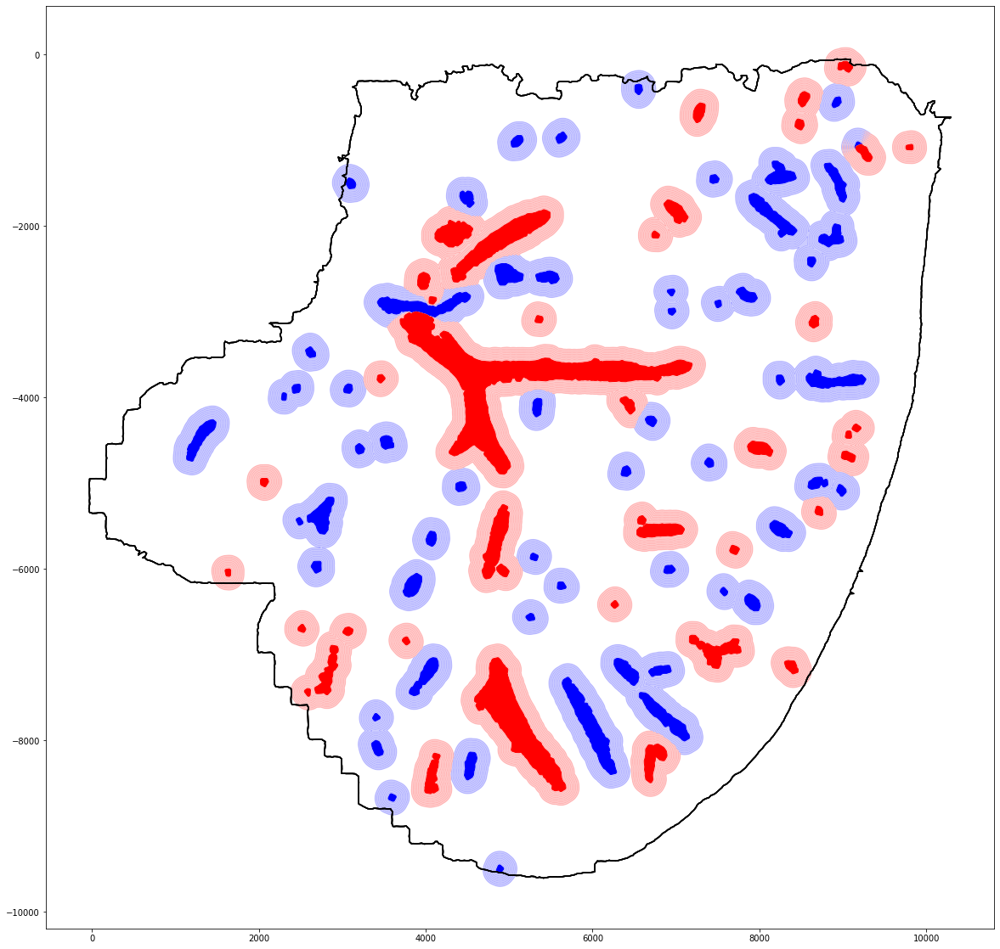

In [ ]:
figsize=20
plt.figure(figsize=(figsize, figsize))
for index_donut in distances[1:]:
  inst_central = central_donuts.loc[index_donut, 'geometry']
  inst_portal = portal_donuts.loc[index_donut, 'geometry']
  plt.plot(*liver.exterior.xy, color='black', alpha=0.5)
  # central donuts
  for inst_geo in inst_central.geoms:
    central_boundary = inst_geo.exterior.xy
    # central_boundary = liver.intersection(inst_geo).exterior.xy
    if index_donut == 0:
      alpha = 1.0
    else:
      alpha = 0.2
    plt.fill(*central_boundary, color='white', alpha=1)
    plt.fill(*central_boundary, color='blue', alpha=alpha)
  # portal donuts
  for inst_geo in inst_portal.geoms:
    central_boundary = inst_geo.exterior.xy
    # central_boundary = liver.intersection(inst_geo).exterior.xy
    if index_donut == 0:
      alpha = 1
    else:
      alpha = 0.2 # 1 - float(index_donut/10)
    plt.fill(*central_boundary, color='white', alpha=1)
    # print('alpha', alpha)
    plt.fill(*central_boundary, color='red', alpha=alpha)

### Leiden Clusters Correlated with Proximity to Portal/Central Blood Vessels
Here we identify Leiden clusters with high correlation with respect to proximity to blood vessels. This is defined by calculating the cell cluster distributions for each distance threshold and calculating the Pearson correlation of each Leiden cluster population with respect to decreasing distance to all portal or central blood vessels.

In [ ]:
# leiden correlation with portal vein distance
portal_corr_leiden = pd.Series()
for inst_leiden in portal_leiden.index.tolist():
  corr, pval = stats.pearsonr(portal_leiden.loc[inst_leiden], distances)
  portal_corr_leiden[inst_leiden] = corr

# genes correlation with central vein distance
central_corr_leiden = pd.Series()
for inst_leiden in central_leiden.index.tolist():
  corr, pval = stats.pearsonr(central_leiden.loc[inst_leiden], distances)
  central_corr_leiden[inst_leiden] = corr

<IPython.core.display.Javascript object>

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecationWarning:

The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DeprecationWarning:

The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.



#### Top Portal Clusters
The top correlated peri-portal clusters include several mgakaryocyte and/or endothelial (Vwf expressing) clusters (Leiden-23, Leiden-20, Leiden-16) and one large hepatocyte cluster (Leiden-0). The y axis shows proportion of cells in region belonging to the cell cluster.

In [ ]:
top_corr = portal_corr_leiden.sort_values(ascending=False).index.tolist()
top_corr_named = [leiden_names[int(x)] for x in top_corr][:5]
portal_leiden_named = deepcopy(portal_leiden.loc[top_corr])
portal_leiden_named.index = [leiden_names[int(x)] for x in portal_leiden.index.tolist()]
portal_leiden_named.columns = [buffer_dist * (int(x) + 1) for x in portal_leiden_named.columns.tolist()]
portal_leiden_named.index.name = 'Cluster'
portal_leiden_named.columns.name = 'Distance (um)'
portal_leiden_named = portal_leiden_named.loc[top_corr_named]
fig = px.line(portal_leiden_named.transpose(),  width=1000)
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
num_top_leidens = 2
ser_sort = portal_corr_leiden.sort_values(ascending=False).head(10)
top_portal_leiden = ser_sort.index.tolist()[:num_top_leidens]
# ser_sort.plot(kind='bar', title='Top Portal Genes')

<IPython.core.display.Javascript object>

#### Top Central Clusters
The top correlated peri-portal clusters include several mgakaryocyte and/or endothelial (Vwf expressing) clusters (Leiden-16, Leiden-22) and one hepatocyte clusters (Leiden-6).

In [ ]:
top_corr = central_corr_leiden.sort_values(ascending=False).index.tolist()
top_corr_named = [leiden_names[int(x)] for x in top_corr][:5]
central_leiden_named = deepcopy(central_leiden.loc[top_corr])
central_leiden_named.index = [leiden_names[int(x)] for x in central_leiden.index.tolist()]
central_leiden_named.columns = [buffer_dist * (int(x) + 1) for x in central_leiden_named.columns.tolist()]
central_leiden_named.index.name = 'Cluster'
central_leiden_named.columns.name = 'Distance (um)'
central_leiden_named = central_leiden_named.loc[top_corr_named]
fig = px.line(central_leiden_named.transpose(),  width=1000)
fig.show()

<IPython.core.display.Javascript object>

In [ ]:
ser_sort = central_corr_leiden.sort_values(ascending=False).head(10)
top_central_leiden = ser_sort.index.tolist()[:num_top_leidens]
# ser_sort.plot(kind='bar', title='Top Central Genes')

<IPython.core.display.Javascript object>

#### Top Peri-Portal and Peri-Central Cell Clusters
Here we plot cells from the top two peri-portal (red) and peri-portal (blue) correlated clusters.We see the distinct and non-overlapping spatial organization of these clusters throughout the tissue.

<IPython.core.display.Javascript object>

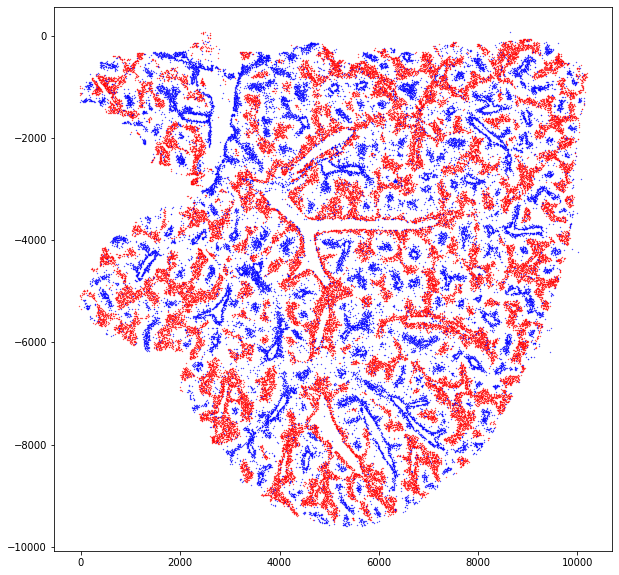

In [ ]:
figsize=10
plt.figure(figsize=(figsize, figsize))
portal_cells = ad_viz.obs[ad_viz.obs['leiden'].isin(top_portal_leiden)]
plt.scatter(portal_cells.center_x, -portal_cells.center_y, s=0.1, color='red')
central_cells = ad_viz.obs[ad_viz.obs['leiden'].isin(top_central_leiden)]
plt.scatter(central_cells.center_x, -central_cells.center_y, s=0.1, color='blue')

### Genes Correlated with Proximity to Portal/Central Blood Vessels
Here we calculate genes that are most correlated with proximity to portal and central blood vessels. This is done by first calculating the average gene expression of each gene for the cells within each distance threshold and then calculating the Pearson correlation of each gene with respect to decreasing distance to portal/central blood vessels.

In [ ]:
# genes correlation with portal vein distance
portal_corr_gene = pd.Series()
for inst_gene in portal_exp.index.tolist():
  corr, pval = stats.pearsonr(portal_exp.loc[inst_gene], distances)
  portal_corr_gene[inst_gene] = corr

# genes correlation with central vein distance
central_corr_gene = pd.Series()
for inst_gene in central_exp.index.tolist():
  corr, pval = stats.pearsonr(central_exp.loc[inst_gene], distances)
  central_corr_gene[inst_gene] = corr

<IPython.core.display.Javascript object>

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  


In [ ]:
top_exp_genes = cell_by_gene.sum(axis=0).sort_values(ascending=False).index.tolist()[:100]

<IPython.core.display.Javascript object>

#### Top Portal Correlated Genes

In [ ]:
portal_top_genes = portal_corr_gene[top_exp_genes].sort_values(ascending=False).head(5).index.tolist()
portal_exp_named = portal_exp.loc[portal_top_genes]
portal_exp_named.columns = [buffer_dist * (int(x) + 1) for x in portal_exp_named.columns.tolist()]
portal_exp_named.columns.name = 'Distance (um)'
portal_exp_named.index.name = 'Gene'

fig = px.line(portal_exp_named.transpose(),  width=1000)
fig.show()

<IPython.core.display.Javascript object>

#### Top Central Correlated Genes

In [ ]:
central_top_genes = central_corr_gene[top_exp_genes].sort_values(ascending=False).head(5).index.tolist()
central_exp_named = central_exp.loc[central_top_genes]
central_exp_named.columns = [buffer_dist * (int(x) + 1) for x in central_exp_named.columns.tolist()]
central_exp_named.columns.name = 'Distance (um)'
central_exp_named.index.name = 'Gene'

fig = px.line(central_exp_named.transpose(),  width=1000)
fig.show()

<IPython.core.display.Javascript object>

### Example Gene Correlation with Proximity to Portal and Central Veins

Portal: Aldhb1
Central: Cyp1a2



In [ ]:
portal_gene = 'Aldh1b1'
central_gene = 'Cyp1a2'
load_genes = [portal_gene, central_gene]

filename = base_path + dataset_name + 'detected_transcripts.csv'
usecols = ['global_x', 'global_y', 'gene']

transcripts_portal = None
transcripts_central = None
for chunk in pd.read_csv(filename, chunksize=1e6, usecols=usecols):

  inst_portal = chunk[chunk['gene'] == portal_gene]
  inst_central = chunk[chunk['gene'] == central_gene]

  if transcripts_portal is None:
    transcripts_portal = inst_portal
  else:
    transcripts_portal = pd.concat([transcripts_portal, inst_portal], axis=0)

  if transcripts_central is None:
    transcripts_central = inst_central
  else:
    transcripts_central = pd.concat([transcripts_central, inst_central], axis=0)

print(str(transcripts_portal.shape[0]) +  portal_gene + ' transcripts')
print(str(transcripts_central.shape[0]) +  central_gene + ' transcripts')

<IPython.core.display.Javascript object>

1554333Aldh1b1 transcripts
6591263Cyp1a2 transcripts


### Representative Portal (Aldh1b1: red) and Central (Cyp1a2: blue) Correlated Genes
Here we can see the expression pattern of two top Portal and Central correlated genes:(Aldh1b1: red) and Central (Cyp1a2: blue). These genes display strong spaital localzation with respect to blood vessels and appear to show little spatial overlap.


<IPython.core.display.Javascript object>

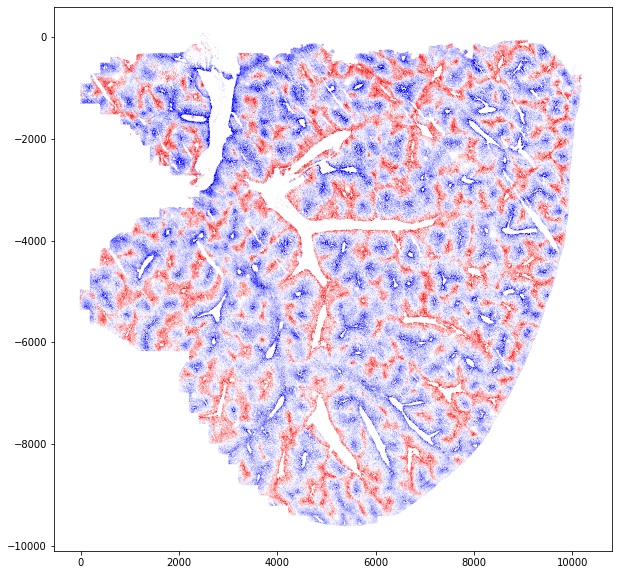

In [ ]:
figsize=10
plt.figure(figsize=(figsize, figsize))
plt.scatter(transcripts_central.global_x, -transcripts_central.global_y, s=0.01, color='blue', alpha=0.01)
plt.scatter(transcripts_portal.global_x, -transcripts_portal.global_y, s=0.01, color='red', alpha=0.05)

# Cell Cluster Alpha Shape Neighborhood
Here we use an alpha shape approach to define cell-cluster neighborhoods and identify clusters of highly overlapped cell types. We define overlap using the intersect-over-union metric and hierarchically cluster the overlap matrix to identify clusters of cell-cluster neighborhoods.

In [ ]:
alpha = 75

# Calculate Alpha Shapes
#################################
deckgl_polygons, deckgl_points, contained_points = calc_alpha_shapes_for_deckgl(df_points, alpha=alpha)

# Calculate Neighborhood Shapely Multipolygons
################################################
nbhds, meta_nbhds, meta_regions = calc_neighborhood_multipolygons(deckgl_polygons)

# Add more metadata to meta_nbhds
for inst_leiden in contained_points:
  # transfer the number of contained points to meta_nbhds
  num_contained = len(contained_points[inst_leiden])
  meta_nbhds.loc[inst_leiden, 'contained_cells'] = num_contained

  # calculate the tottal number of cells in the cluster
  num_total_cells = df_points[df_points['leiden'] == inst_leiden].shape[0]
  meta_nbhds.loc[inst_leiden, 'total_cells'] = num_total_cells

  # calculate the fraction of contained cells in the neighborhood
  meta_nbhds.loc[inst_leiden, 'fraction_contained'] = num_contained/num_total_cells


<IPython.core.display.Javascript object>

calc_alpha_shapes_for_deckgl


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:50: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for addi

In [ ]:
ser_check = meta_regions['area']/meta_regions['area_no_holes']
ser_check.sort_values(ascending=True).head(20)

<IPython.core.display.Javascript object>

cluster-11_region-3      0.523675
cluster-4_region-7       0.590132
cluster-8_region-277     0.595530
cluster-3_region-0       0.624002
cluster-8_region-183     0.631620
cluster-7_region-271     0.637436
cluster-8_region-276     0.642949
cluster-11_region-92     0.653719
cluster-12_region-93     0.656189
cluster-10_region-187    0.656716
cluster-1_region-1       0.668297
cluster-2_region-0       0.669786
cluster-3_region-45      0.675587
cluster-13_region-115    0.677949
cluster-0_region-1       0.679741
cluster-9_region-4       0.686669
cluster-8_region-13      0.693126
cluster-8_region-27      0.695116
cluster-7_region-5       0.698176
cluster-5_region-4       0.704788
dtype: float64

In [ ]:
meta_regions['num_holes'].sort_values(ascending=False)

<IPython.core.display.Javascript object>

cluster-3_region-0       568.0
cluster-1_region-0       204.0
cluster-2_region-0       135.0
cluster-4_region-0        46.0
cluster-3_region-2        42.0
                         ...  
cluster-10_region-515      0.0
cluster-10_region-516      0.0
cluster-10_region-517      0.0
cluster-10_region-518      0.0
cluster-29_region-0        0.0
Name: num_holes, Length: 12994, dtype: float64

<IPython.core.display.Javascript object>

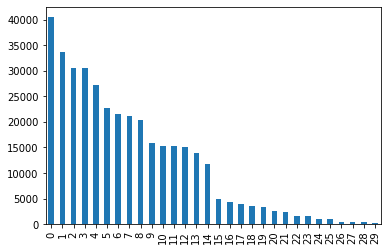

In [ ]:
meta_nbhds['total_cells'].plot(kind='bar')

<IPython.core.display.Javascript object>

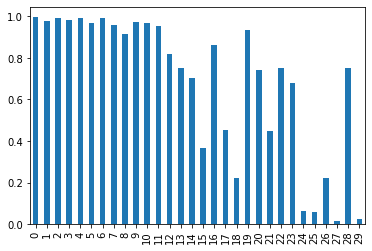

In [ ]:
meta_nbhds['fraction_contained'].plot(kind='bar')

<IPython.core.display.Javascript object>

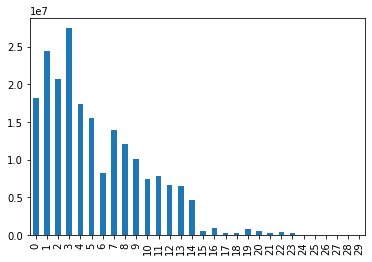

In [ ]:
meta_nbhds['area'].plot(kind='bar')

<IPython.core.display.Javascript object>

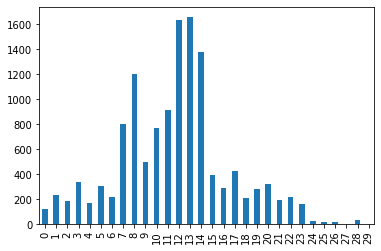

In [ ]:
meta_nbhds['num_regions'].plot(kind='bar')

<IPython.core.display.Javascript object>

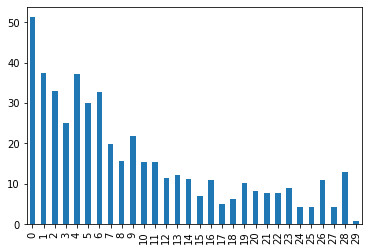

In [ ]:
meta_nbhds['area_per_perimeter'].plot(kind='bar')

## Calculate Neighborhood Intersection over Union

In [ ]:
cluster_numbers = [np.int(x) for x in df_points['leiden'].unique().tolist()]

ordered_cluster_names = [str(y) for y in sorted(cluster_numbers)]

df_contains = pd.DataFrame(0.0, index=ordered_cluster_names, columns=ordered_cluster_names)

ser_points_all = df_points[["x", "y"]].apply(Point, axis=1)

total_cells = df_points.shape[0]

for nbhd_col_name in ordered_cluster_names:

  nbhd_col = nbhds[nbhd_col_name]
  nbhd_col_area = nbhd_col.area

  for nbhd_row_name in ordered_cluster_names:

    nbhd_row = nbhds[nbhd_row_name]

    if nbhd_col_area > 0:
      intersection_area = nbhd_col.buffer(0).intersection(nbhd_row.buffer(0)).area
      union_area = nbhd_col.buffer(0).union(nbhd_row.buffer(0)).area
      iou = intersection_area/union_area
    else:
      ioa = 0

    df_contains.loc[nbhd_row_name, nbhd_col_name] = iou

from copy import deepcopy
df_contain_viz = deepcopy(df_contains)
df_contain_viz.index = ['Leiden-' + str(x) for x in df_contain_viz.index.tolist()]
df_contain_viz.columns = ['Leiden-' + str(x) for x in df_contain_viz.columns.tolist()]


max_iou = 0.25
df_contain_viz[df_contain_viz > max_iou] = max_iou

<IPython.core.display.Javascript object>

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/pandas/core/dtypes/cast.py:118: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)


### Neighborhood Dashboard Code

In [ ]:
# df_contain_viz

<IPython.core.display.Javascript object>

In [ ]:
df_contain_viz.index = meta_leiden.index.tolist()
df_contain_viz.columns = meta_leiden.index.tolist()

<IPython.core.display.Javascript object>

In [ ]:
# cluster leiden neighborhoods based on overlap
net = Network(CGM2)
net.load_df(df_contain_viz,
            meta_col=meta_leiden, col_cats=['leiden', 'Cell_Type', 'cell counts'],
            meta_row=meta_leiden, row_cats=['leiden', 'Cell_Type', 'cell counts'])
net.swap_nan_for_zero()
net.filter_threshold(0.01, axis='row')
net.filter_threshold(0.01, axis='col')
net.set_global_cat_colors(df_colors)
net.cluster()

url = '@vizgen/neighborhood-heatmap-0-2-1'
inputs = {
  'height': 800,
  'zoom': -3.75,
  'cluster_colors': cat_colors,
  # 'deckgl_points': deckgl_points,
  'deckgl_polygons': deckgl_polygons,
  'network': net.viz,
  'center_x': 5000,
  'center_y': 5000
}

<IPython.core.display.Javascript object>

## Leiden Cluster Neighborhood Overlap
Here we can visualize Leiden cell-cluster neighborhoods and neighborhood overlap (measured as intersection over union). We see two groups of largely hepatocyte Leiden cluster neighborhoods and two groups of blood vessel adjacent Leiden cluster neighborhoods.

In [ ]:
embed(url, cells=['viewof cgm', 'dashboard'], inputs=inputs, display_logo=False)

<IPython.core.display.Javascript object>

### Hepatic Neighborhood Overlap Dashboard

In [ ]:
net = Network(CGM2)
keep_leiden = meta_leiden[meta_leiden['Cell_Type'] == 'Hepatocyte'].index.tolist()


net.load_df(df_contain_viz.loc[keep_leiden, keep_leiden],
            meta_col=meta_leiden, col_cats=['leiden', 'Cell_Type', 'cell counts'],
            meta_row=meta_leiden, row_cats=['leiden', 'Cell_Type', 'cell counts'])
net.swap_nan_for_zero()
net.filter_threshold(0.01, axis='row')
net.filter_threshold(0.01, axis='col')
net.set_global_cat_colors(df_colors)
net.cluster()

deckgl_polygons_hepat = [x for x in deckgl_polygons if 'Hepatocyte_Leiden-' + x['neighborhood'] in keep_leiden]

url = '@vizgen/neighborhood-heatmap-0-2-1'
inputs = {
  'height': 800,
  'zoom': -3.75,
  'cluster_colors': cat_colors,
  # 'deckgl_points': deckgl_points,
  'deckgl_polygons': deckgl_polygons_hepat,
  'network': net.viz,
  'center_x': 5000,
  'center_y': 5000
}

<IPython.core.display.Javascript object>

## Hepatic Leiden Cluster Neighborhood Overlap
Here we can visualize hepatic Leiden cell-cluster neighborhoods and neighborhood overlap. Again we see peri-portal and per-central hepatocytes as well as two clusters (Leiden-10 and Leiden-11) which are positioned midway between portal and central blood vessels.

In [ ]:
embed(url, cells=['viewof cgm', 'dashboard'], inputs=inputs, display_logo=False)

<IPython.core.display.Javascript object>